# Extract and mask with polygon
This notebook will extract an area of imagery and clip to the polygon boundaries. This notebook will load derived products (e.g. fractional cover, geomedians) as it uses dc.load rather than load_ard.

In [1]:
import datacube
import xarray as xr
from datacube.drivers.netcdf import write_dataset_to_netcdf
import geopandas as gpd
from datacube.utils import geometry
from datacube.utils.cog import write_cog

import sys
sys.path.insert(1, '../Tools/')
from dea_tools.datahandling import download_unzip
from dea_tools.plotting import rgb
from dea_tools.spatial import xr_rasterize

In [2]:
dc = datacube.Datacube(app='Polygon_drill')

## Input Paramaters
Specify the dat location and time period. Geometries can be from a local shapefile or from an online source.

In [3]:
# Analysis paramaters
polygon_to_drill = '/home/jovyan/DPIPWE_input/DEA_multi__sen_shapes.shp'
time_to_drill = ('2017-08-01', '2018-04-01')

In [4]:
# Read unzipped shapefile
polygon_to_drill = gpd.read_file(polygon_to_drill)

In [5]:
# Check that the polygon loaded as expected. We'll just print the first 3 rows to check
polygon_to_drill.head(3)

,Id,SENSOR,SEN_DATE,NAME,geometry
0,0,SENTINEL,2019-11-16,Jilletts Tier,"POLYGON ((501065.355 5346765.939, 503843.485 5..."
1,0,LANDSAT,2019-01-29,Boobyalla,"POLYGON ((574145.622 5473413.415, 576295.366 5..."
2,0,SENTINEL,2019-01-30,Flinders_multi,"MULTIPOLYGON (((600923.053 5550302.147, 599600..."


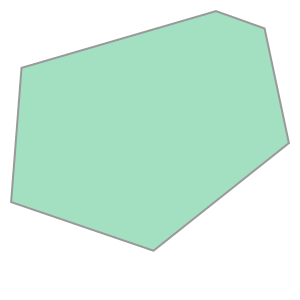

In [6]:
# Grab the geometry and crs from the polygon layer (in this case the first polygon in the table
# (if there is more than one). Change .iloc index to grab other geometries.
geom = geometry.Geometry(geom=polygon_to_drill.iloc[0].geometry, 
                         crs=polygon_to_drill.crs)
geom

In [7]:
# Set up datacube query
query = {'geopolygon': geom,
         'time': time_to_drill,
         'output_crs': 'EPSG:3577',
         'resolution': (-30, 30),
         'measurements': ['nbart_red', 
                          'nbart_green', 
                          'nbart_blue']
        }

In [8]:
# Load data for our polygon bounding box and time period
data = dc.load(product='ga_ls8c_ard_3', group_by='solar_day', **query)

# Check we have some data back with multiple timesteps
data

<xarray.Dataset>
Dimensions:      (time: 29, y: 1283, x: 1659)
Coordinates:
  * time         (time) datetime64[ns] 2017-08-16T00:13:54.883000 ... 2018-03...
  * y            (y) float64 -4.67e+06 -4.67e+06 ... -4.683e+06 -4.683e+06
  * x            (x) float64 1.26e+06 1.26e+06 1.26e+06 ... 1.276e+06 1.276e+06
    spatial_ref  int32 3577
Data variables:
    nbart_red    (time, y, x) int16 2859 2866 2891 2909 2978 ... 450 380 348 405
    nbart_green  (time, y, x) int16 2739 2765 2791 2808 2874 ... 362 293 291 333
    nbart_blue   (time, y, x) int16 2793 2797 2812 2852 2933 ... 280 230 237 256
Attributes:
    crs:           EPSG:3577
    grid_mapping:  spatial_ref

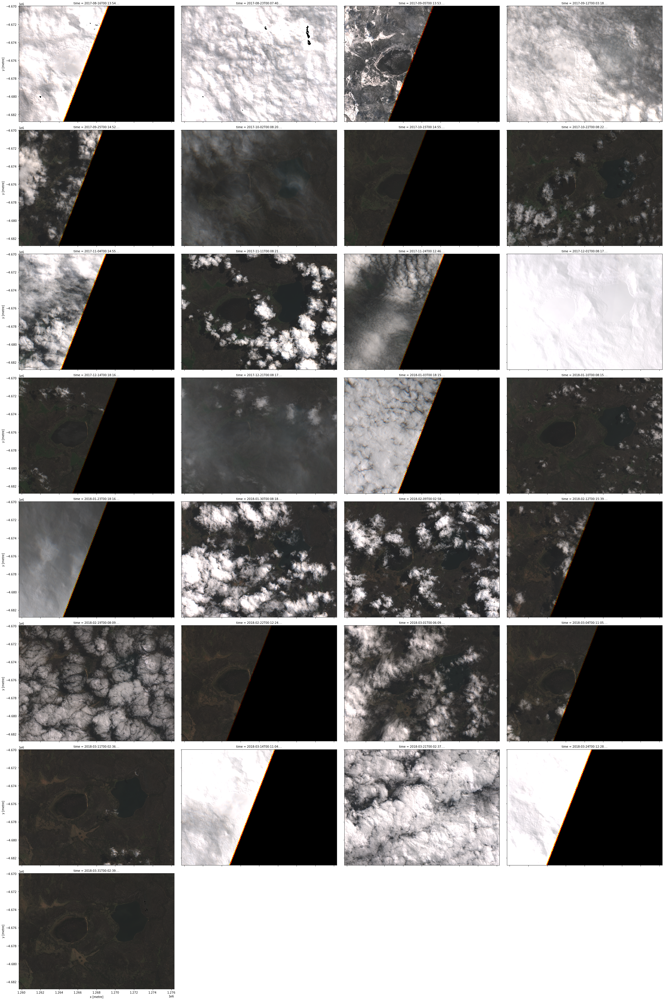

In [9]:
# Plot the time steps
rgb(data, col='time', percentile_stretch=(0.05, 0.95))

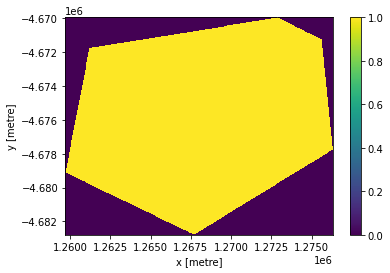

In [42]:
# Mask the dataset to our polygon boundary
# Create a mask of the indexed polygon
mask = xr_rasterize(polygon_to_drill.iloc[[0]], data)

# Plot the mask
mask.plot()

In [43]:
# Run the Mask
data_masked = data.where(mask)

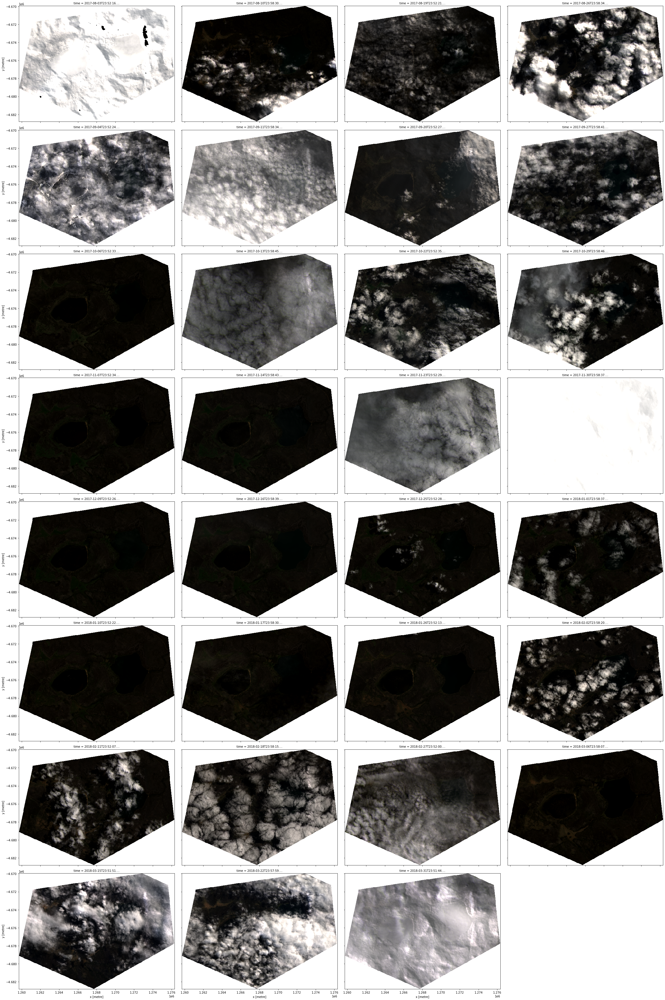

In [44]:
# Plot the masked image
rgb(data_masked, col='time', percentile_stretch=(0.05, 0.95))

## Export data
To export to netcdf

In [ ]:
# To write all time steps (and bands) to netcdf
#write_dataset_to_netcdf(data_masked, 'masked_netcdf.nc')

To export to single time-slice COG (tif)

In [ ]:
# Select a single time-slice and convert to array
rgb_da = data_masked.isel(time=8).to_array()

# Write multi-band GeoTIFF to a location
write_cog(geo_im=rgb_da,
          fname='rgb.tif',
          overwrite=True)

If we want to export all of the time steps in a dataset, we can wrap write_cog in a for-loop and export each time slice as an individual GeoTIFF file

In [32]:
'''
for i in range(len(data_masked.time)):

    # We will use the date of the satellite image to name the GeoTIFF
    date = data_masked.isel(time=i).time.dt.strftime('%Y-%m-%d').data
    print(f'Writing {date}')
    
    # Convert current time step into a `xarray.DataArray`
    singletimestamp_da = data_masked.isel(time=i).to_array()

    # Write GeoTIFF  
    write_cog(geo_im=singletimestamp_da,
              fname=f'{date}.tif',
              overwrite=True)
'''

"\nfor i in range(len(data_masked.time)):\n\n    # We will use the date of the satellite image to name the GeoTIFF\n    date = data_masked.isel(time=i).time.dt.strftime('%Y-%m-%d').data\n    print(f'Writing {date}')\n    \n    # Convert current time step into a `xarray.DataArray`\n    singletimestamp_da = data_masked.isel(time=i).to_array()\n\n    # Write GeoTIFF  \n    write_cog(geo_im=singletimestamp_da,\n              fname=f'{date}.tif',\n              overwrite=True)\n"

In [ ]:
help(dc.load)

Help on method load in module datacube.api.core:

load(product=None, measurements=None, output_crs=None, resolution=None, resampling=None, skip_broken_datasets=False, dask_chunks=None, like=None, fuse_func=None, align=None, datasets=None, dataset_predicate=None, progress_cbk=None, **query) method of datacube.api.core.Datacube instance
    Load data as an ``xarray.Dataset`` object.  Each measurement will be a data variable in the :class:`xarray.Dataset`.
    
    See the `xarray documentation <http://xarray.pydata.org/en/stable/data-structures.html>`_ for usage of the
    :class:`xarray.Dataset` and :class:`xarray.DataArray` objects.
    
    **Product and Measurements**
        A product can be specified using the product name, or by search fields that uniquely describe a single
        product.
        ::
    
            product='ls5_ndvi_albers'
    
        See :meth:`list_products` for the list of products with their names and properties.
    
        A product can also be selecte